## Experiments on Pre-trained CompVis/stable-diffusion-v1-4

To conduct some simple experiments with the pre-trained diffusion model.

The diffusion model provided by the diffuser library, which is trained on images and text jointly is used. It can take prompts and generate images accordingly.

In this notebook, two interplotation strategies are expiremented:
- Fixed $x_T$, and interplotation between two prompts.
- Fixed prompts and interplotation between values of $x_T$.

where $x_T$ denotes the noise at the end of the diffusion process.

Run the following code to install required packages and get the model ready. 

**Note** Run on GPU using Google Colab.

In [4]:
# Install the packages
!pip install diffusers
!pip install transformers scipy ftfy accelerate


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.6/302.6 kB 9.2 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux

In [5]:
from PIL import Image
from IPython import display as IPdisplay
import time
import os
import numpy as np
import matplotlib.pyplot as plt

def display_images(images, save_path):
    try:
        # Convert each image in the 'images' list from an array to an Image object.
        images = [
            Image.fromarray(np.array(image, dtype=np.uint8)) for image in images
        ]

        # Generate a file name based on the current time, replacing colons with hyphens
        # to ensure the filename is valid for file systems that don't allow colons.
        filename = (
            time.strftime("%H:%M:%S", time.localtime())
            .replace(":", "-")
        )
        # Save the first image in the list as a GIF file at the 'save_path' location.
        # The rest of the images in the list are added as subsequent frames to the GIF.
        # The GIF will play each frame for 100 milliseconds and will loop indefinitely.
        images[0].save(
            f"{save_path}/{filename}.gif",
            save_all=True,
            append_images=images[1:],
            duration=100,
            loop=0,
        )
    except Exception as e:
        # If there is an error during the process, print the exception message.
        print(e)

    # Return the saved GIF as an IPython display object so it can be displayed in a notebook.
    return IPdisplay.Image(f"{save_path}/{filename}.gif")


def display_images_in_grid(images, rows=4, cols=5, figsize=(10, 8)):
  """
  Display a list of PIL images in a grid.

  Args:
      images (list of PIL.Image.Image): List of PIL Image objects.
      rows (int): Number of rows in the grid.
      cols (int): Number of columns in the grid.
      figsize (tuple): Size of the figure.

  Raises:
      ValueError: If the number of images exceeds the grid capacity.
  """
  if len(images) > rows * cols:
      raise ValueError(f"Number of images ({len(images)}) exceeds the grid capacity ({rows * cols}).")

  fig, axes = plt.subplots(rows, cols, figsize=figsize)
  axes = axes.flatten()

  for ax, img in zip(axes, images):
      ax.imshow(img)
      ax.axis('off')

  # Hide any remaining empty subplots
  for ax in axes[len(images):]:
      ax.axis('off')

  plt.tight_layout()
  plt.show()

In [6]:
# Load the model, make sure that you are running on a GPU
import torch
from diffusers import StableDiffusionPipeline

pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16)
# pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4")
pipe = pipe.to("cuda")
# pipe = pipe.to("cpu")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

(…)kpoints/scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Now you have the model ready, run the cell below to do some generation

  0%|          | 0/50 [00:00<?, ?it/s]

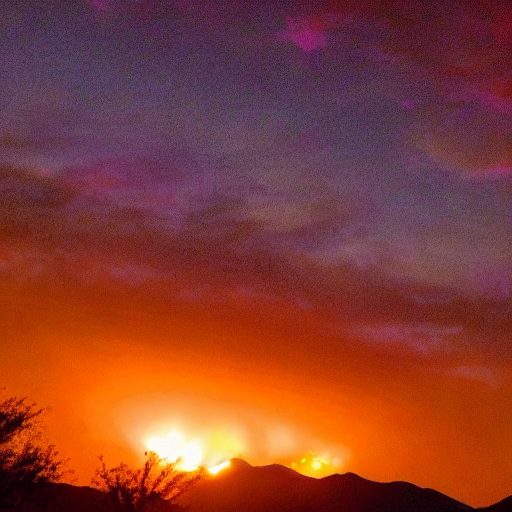

In [7]:
prompt = "the arizona sky burning in your eyes"
image = pipe(prompt).images[0]
image

## Prompt interplotation

To begin with, get the embeddings from two prompts

In [8]:
def get_prompt_embedding(prompt):
  prompt_tokens = pipe.tokenizer(
    prompt,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
  )
  prompt_embeds = pipe.text_encoder(prompt_tokens.input_ids.to('cuda'))[0]
  return prompt_embeds

with torch.autograd.no_grad():
  prompt_1_embedding = get_prompt_embedding("Maine coon swimming")
  prompt_2_embedding = get_prompt_embedding("Maine coon running")

In [9]:
!mkdir -p /output

Z = torch.randn(
    (1, pipe.unet.config.in_channels, 64, 64), dtype=torch.float16
).cuda()


### Linear Interpolation on prompt

Perform linear interplotation between `prompt_1_embedding` and `prompt_2_embedding` with `num_interpolation_steps` steps in total.

Store the interplotation in the `embeddings` list.

It should ends up as a list of length 20,

In [12]:
embeddings = []
num_interpolation_steps = 20
for i in range(num_interpolation_steps):
  alpha = i / (num_interpolation_steps - 1)
  interpolated_embedding = (1 - alpha) * prompt_1_embedding + alpha * prompt_2_embedding
  embeddings.append(interpolated_embedding)

In [13]:
assert len(embeddings) == num_interpolation_steps

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

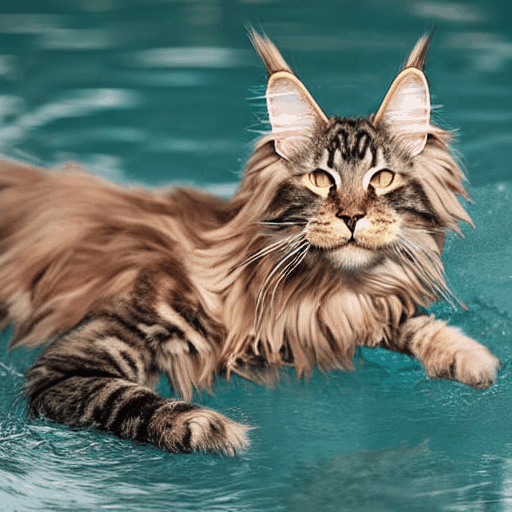

In [14]:
images = []
for latent in embeddings:
    images.append(
        pipe(
            height=64,
            width=64,
            num_images_per_prompt=1,
            prompt_embeds=latent,
            latents=Z,
        ).images[0]
    )

# Display of saved generated images.
display_images(images, "/output")

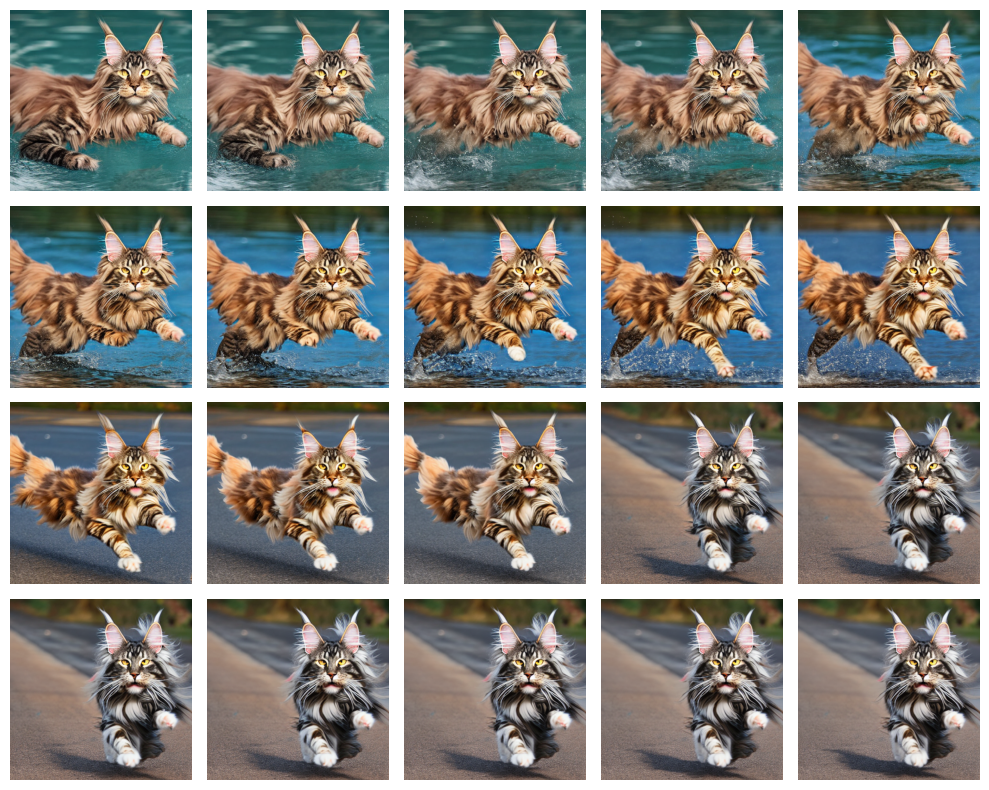

In [15]:
# Also, make sure the run this cell for generate a static version of the images
display_images_in_grid(images)

## Interpolation on Z

Fix the prompt and perform interplotation between the input noise of model. This can be considered as: We fix the content in the image, but vary the "style".

Similar to the previous task, store the linear interplotation between Z1 and Z2 in `embeddings`.

In [16]:
# Randomly generate two Z

Z1 = torch.randn(
    (1, pipe.unet.config.in_channels, 64, 64), dtype=torch.float16
).cuda()

Z2 = torch.randn(
    (1, pipe.unet.config.in_channels, 64, 64), dtype=torch.float16
).cuda()

In [1]:
embeddings = []
num_interpolation_steps = 20
for i in range(num_interpolation_steps):
  alpha = i / (num_interpolation_steps - 1)
  interpolated_embedding = (1 - alpha) * Z1 + alpha * Z2
  embeddings.append(interpolated_embedding)

NameError: name 'Z1' is not defined

After acquiring the embeddings, again, run the following code for sample generation and some visualizations.

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

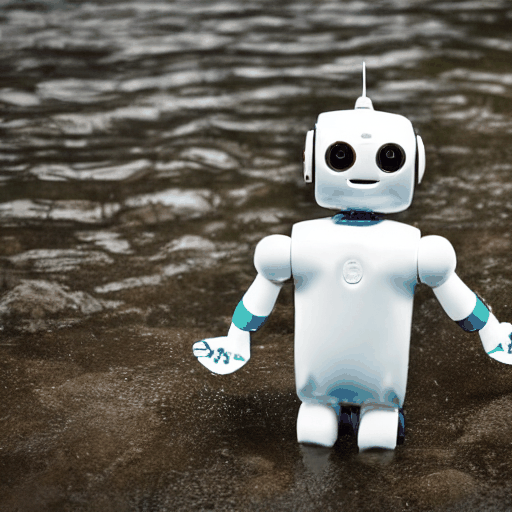

In [18]:
images = []
for latent in embeddings:
    images.append(
        pipe(
            'A swimming robot', # Or anything you want!!!
            height=64,
            width=64,
            num_images_per_prompt=1,
            latents=latent,
        ).images[0]
    )

# Display of saved generated images.
display_images(images, "/output")

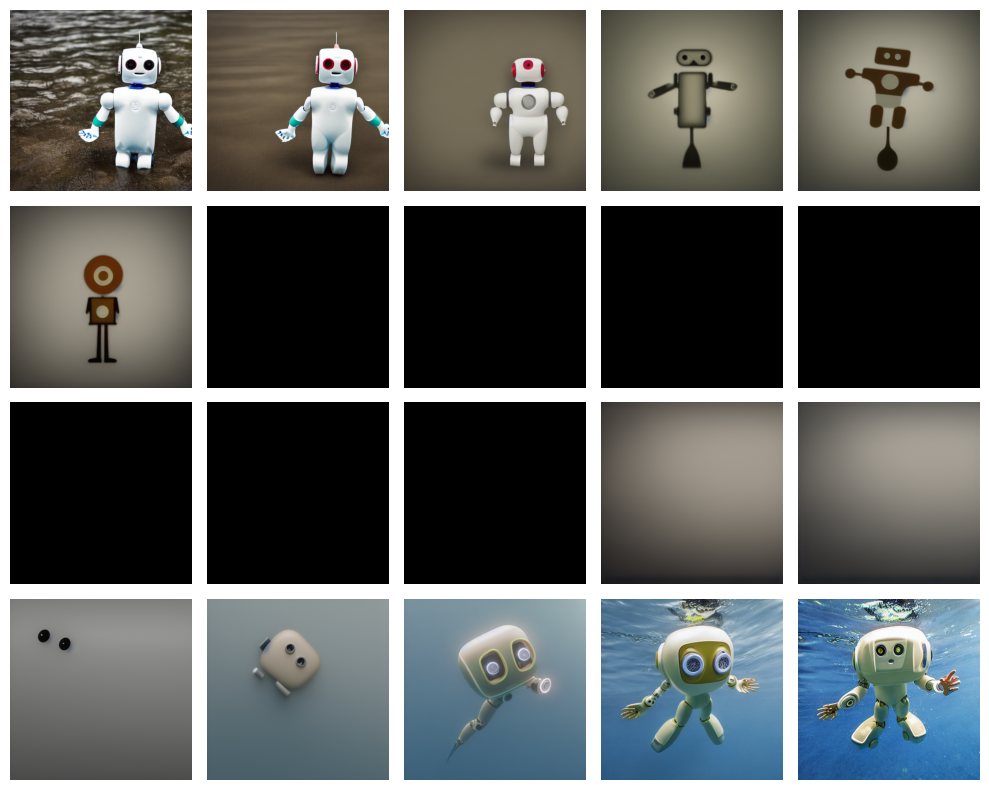

In [19]:
# Also, make sure the run this cell for generate a static version of the images
display_images_in_grid(images)

## Failure of diffusion

Lastly, two prompts are provided where the diffusion model obviously fails to generate sensible images or show extremely undesirable behavior.

  0%|          | 0/50 [00:00<?, ?it/s]

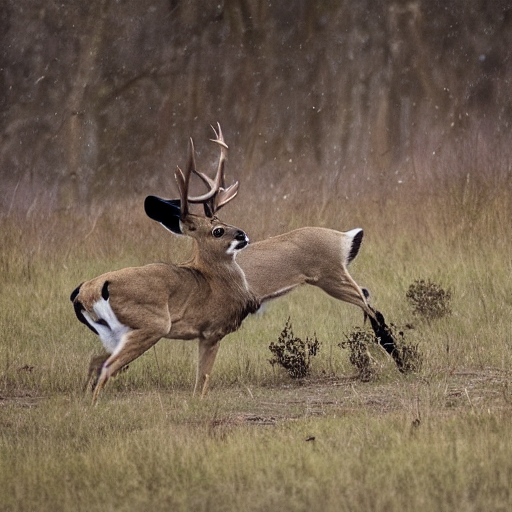

In [26]:
# Case 0
prompt = "A deer hunting a lion"
image = pipe(prompt).images[0]
image

This image doesn't look real and moreover there isn't a lion in the picture. This is purely due to lack of training data because there isn't such image for real in the training data.

  0%|          | 0/50 [00:00<?, ?it/s]

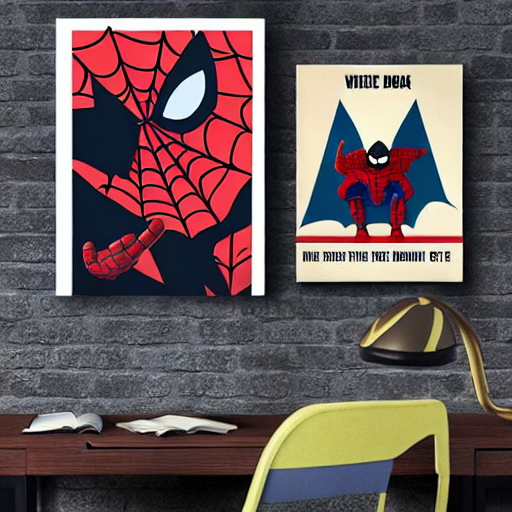

In [51]:
# Case 1
prompt = "Create a poster with spiderman and batman"
image = pipe(prompt).images[0]
image

This is also due to limited training data related to this specific scenario. Although individual images of spiderman and batman could be present in the dataset, the model fails to combine them as per the prompt. The model is unable to handle prompts with multiple embedding while generating samples.

## Spherical linear interpolation (SLERP)

It has been noticed that sperical linear interplotation could sometime give better results, see, e.g.
   
Andrej Karpathy's gist: https://gist.github.com/karpathy/00103b0037c5aaea32fe1da1af553355.        
Or: https://en.wikipedia.org/wiki/Slerp.

In this task, spherical linear interpolation is used to interpolate in Z space.

In [27]:
Z1 = torch.randn(
    (1, pipe.unet.config.in_channels, 64, 64), dtype=torch.float16
).cuda()

Z2 = torch.randn(
    (1, pipe.unet.config.in_channels, 64, 64), dtype=torch.float16
).cuda()

In [30]:
import torch

def slerp(Z1, Z2, t):
    omega = torch.acos(torch.sum(Z1 / torch.norm(Z1) * (Z2 / torch.norm(Z2))))
    so = torch.sin(omega)
    return torch.sin((1 - t) * omega) / so * Z1 + torch.sin(t * omega) / so * Z2

In [32]:
embeddings = []
num_interpolation_steps = 20
for i in range(num_interpolation_steps):
    alpha = i / (num_interpolation_steps - 1)
    interpolated_embedding = slerp(Z1, Z2, alpha)
    embeddings.append(interpolated_embedding)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

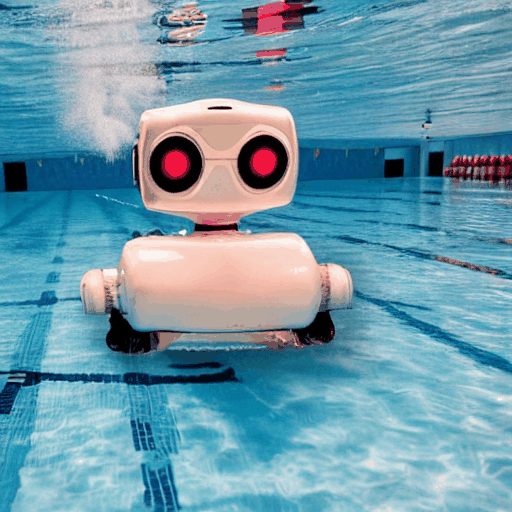

In [33]:
images = []
for latent in embeddings:
    images.append(
        pipe(
            'A swimming robot', # Or anything you want!!!
            height=64,
            width=64,
            num_images_per_prompt=1,
            latents=latent,
        ).images[0]
    )

# Display of saved generated images.
display_images(images, "/output")

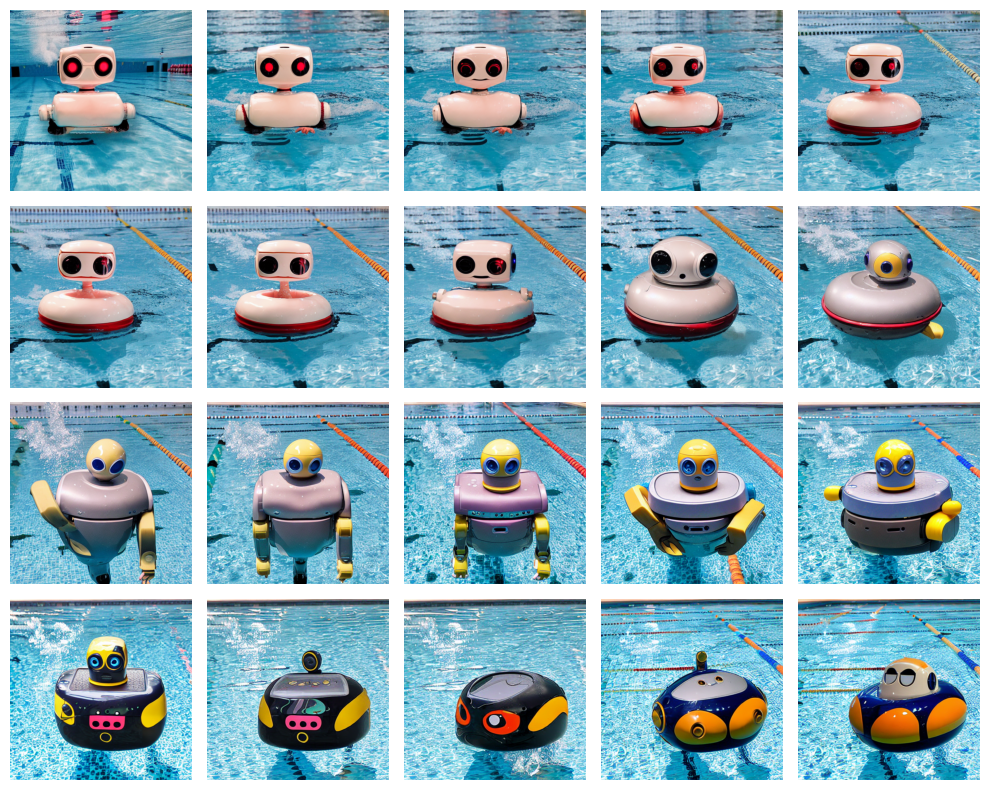

In [34]:
display_images_in_grid(images)

The pictures are better from spherical linear interpolation. These images are smoother, visually coherent and transform organically compared to linear interpolation.
Slerp is preferrable as it follows geodesic path capturing intrinsic geometry of data accurately, preserves unit norm of vectors being interpolated, maintains a constant angular velocity and produces smoother interpolations which mitigate overfitting.